<br> <img src="https://serea2017.uniandes.edu.co/images/Logo.png" height="80" width="150" align="Center" /> <br>
    
<br>
<center> <h2>Maestría en Inteligencia Analítica para la Toma de Decisiones</h2> </center>
<br>

##### Presentado por:

    Arturo Guerrero            (201823464)
    Carlos Andres Paez Rojas   (201924257)     

<h4> Septiembre 2020 </h4>
<br>

## MIIA-4203 MODELOS AVANZADOS PARA ANÁLISIS DE DATOS II


# Aprendizaje por transferencia con redes neuronales 


### Profesor: Camilo Franco (c.franco31@uniandes.edu.co)

En este cuadernos estudiaremos una implementación de aprendizaje por transferencia utilizando la red pre-entrenada VGG-16. Implementaremos nuestra propio modelo de aprendizaje por trasferencia utilizando la biblioteca (API) Keras (https://keras.io/). 

Finalmente evaluaremos si un modelo más complejo de *deep learning* nos permite lograr un mejor desempeño para la detección automática de frailejones sobre imagenes aereas del páramo.

Primero importemos algunos de los paquetes que vamos a utilizar, junto con las imagenes de entrenamiento:


In [3]:
import numpy as np
import h5py
import matplotlib.pyplot as plt

from ImportImagenesRGB import *
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix 

%load_ext autoreload
%autoreload 2

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

from prettytable import PrettyTable
import datetime

import keras
from keras.models import Sequential, load_model
from keras.optimizers import SGD
from keras.layers import Conv2D, MaxPooling2D, Activation, Dropout, Flatten, Dense
from keras import applications

from numpy.random import seed
seed(1)
from tensorflow import set_random_seed
set_random_seed(1)

from tensorflow.keras import regularizers

Using TensorFlow backend.


In [6]:
X,Y = import_imagenes_RGB()

print(X.shape, Y.shape, X[0,0,0])

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


**Salida esperada:**

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


## 1. Aprendizaje por transferencia

En pocas palabras, el aprendizaje por transferencia tiene su historia en la psicología, refiriendose a situaciones donde las personas aplican concimiento, estrategias y aptitudes que han aprendido previamente para enfrentar una nueva situación bajo un contexto **relacionado**. Dentro del aprendizaje computacional, este tipo de aprendizaje se enfoca en guardar un tipo de conocimiento que ya se ha mostrado útil para resolver un problema, y aplicarlo para resolver otro problema distinto pero **relacionado**.

Hay que tener en cuenta que si un modelo de transferencia tiene un efecto negativo sobre el desempeño del modelo, entonces tendremos una transferencia negativa (lo cual no es deseable). De este modo, el reto de los métodos de transferencia es el de producir una transferencia positiva entre tareas apropiadamente relacionadas, evitando transferencias negativas entre tareas poco relacionadas (ver Torrey & Shavlik (2009) Transfer learning). 

El ejemplo que vamos a ver a continuación es un tipo de aprendizaje por transferencia inductivo, característico de las redes neuronales, el cual se ajusta de acuerdo con la coincidencia de un conocimiento previo sobre la fuente de información y la tarea que se propone solucionar. En particular, vamos a llevar a cabo un *aprendizaje por transferencia inductivo-jerárquico*, buscando soluciones a tareas sencillas mediante la combinación de herramientas desarrolladas para tareas más complejas. Entonces, usamos el aprendizaje de una red pre-entrenada, la VGG-16, para aprovechar su conocimiento sobre formas, contornos, bordes, etc. que podemos hacer propias para terminar de entender mejor el problema de clasificación de frailejones, y esperamos mejorar el desempeño de los modelos.


### VGG-16

La red VGG-16 fue propuesta por Simonyan & Zisserman (2015) en Very deep CNN for large-scale image recognition, siguiendo los principios presentados en Ciresan et al. (2011): Flexible, High Performance Convolutional Neural Networks for Image Classification.

La arquitectura de la VGG-16 le permitió ganar la competición ILSVR(Imagenet) 2014 (http://www.image-net.org/challenges/LSVRC/2014/results). Los principios de esta arquitectura consisten en considerar filtros convolucionales pequeños (de $3\times 3$), que recorren las imagenes exhaustivamente, con un *stride* de 1, y capas de *max-poling* de $2\times 2$, reduciendo en gran medida el número de hiper-parámetros a optimizar. La red VGG-16 es bastante profunda, con una configuración de 16 capas (con aprox. 138 millones de parámetros): para las primeras 14 capas combina capas convolucionales y capas de agregación, y al final tiene 2 capa densamente conectadas seguidas de una capa de salida *softmax* para clasificación de múltiples clases (ver: https://neurohive.io/en/popular-networks/vgg16/).


Implementemos nuestro ejemplo de aprendizaje por transferencia utilizando la red VGG-16, la cual ha sido entrenada previamente con imagenes RGB y que podemos descargar directamente de Keras:

In [32]:
model0   = applications.VGG16(include_top=False, weights='imagenet')
config_transI = model0.get_config()

Pasamos nuestro conjunto de datos por la red, obteniendo los nuevos patrones de acuerdo con el entendimiento de la red convolucional VGG-16 acerca de las nociones más básicas que encuentra en nuestras imagenes del Páramo:

In [33]:
feat_X = model0.predict(X)

Agregamos unas pocas capas finales para afinar el modelo por transferencia para la tarea específica de detección de imagenes aereas del Páramo:

In [55]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

Y entrenamos esas capas finales:

In [56]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('Transfer_Adam_partseed='+str(r)+'.h5')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Epoca= 99 , accu_v1=0.972972972972973 , accu_v2=0.9210526315789473
Epoca= 90 , accu_v1=0.9189189205298552 , accu_v2=0.8421052600208082
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736842105263158
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.973  | 0.9211 |   99  |
|  1.0   | 0.9189 | 0.8421 |   90  |
|  1.0   |  1.0   | 0.9737 |   99  |
+--------+--------+--------+-------+


Graficamos el desempeño del modelo:

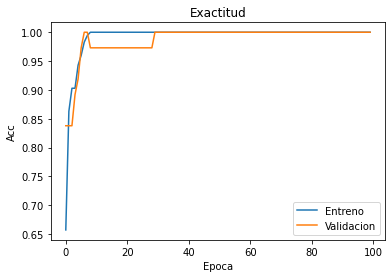

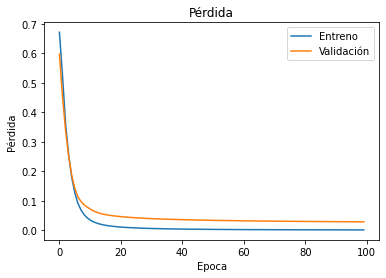

In [57]:
plt.figure(1)
plt.plot(history.history['acc'])  
plt.plot(history.history['val_acc'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

Cargamos el mejor modelo y confirmamos el desempeño del modelo sobre todo el conjunto de datos:

In [16]:
# red convolucional
model_4 = load_model('Transfer_Adam_partseed=1.h5')

model_4.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_2 (Flatten)          (None, 2048)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 5)                 10245     
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


Veamos el desempeño del mejor modelo sobre todo el conjunto de datos:

In [17]:
Y_pred = model_4.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[144,   1],
       [  0, 105]], dtype=int64)

**Salida esperada:**
    
<table style="width:20%">
    <tr>
       <td> 144 </td>
       <td> 1 </td>
    </tr>
    <tr>
       <td> 0 </td>
       <td> 105 </td>
    </tr>

</table>

Podemos observar que el desempeño del modelo a mejorado bastante. 

### Ejercicio 1.1

Encuentre el mejor modelo examinando una configuración distinta para las capas de salida, o siguiendo alguna otra estrategia como puede ser cambiando el optimizador o las funciones de activación.

##### Aunque los resultados observados en el ultimo entrenamiento son muy buenos, únicamente tenemos una observación mal clasificada sobre el total de los datos.
#### A continuación realizaremos diferentes entrenamientos a la red, realizaremos iteraciones combinando el algoritmo de optimización entre Adam, RMSProp y SGD, con inicializadores aleatorio, He y Xavier, así mismo modificando la función de activación en la capa que recibe el aprendizaje por transferencia entre relu, relu con regularización L1 y L2 y sigmoide.


In [75]:
def transferlearning(config_transF, opt, s1, s2, err_p_g):
    # Inicializamos la tabla donde guardamos los resultados
    x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

    # Definimos el número máximo de iteraciones (épocas de la red)
    epocas=100
    
    # Inicializamos el error 
    err_p = err_p_g

    for i in range(0,3,1):
        r = i^3
        CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
        CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)

         # Definimos la arquitectura de la red
        model = Sequential.from_config(config_transF)

        # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
        model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
   
        # Ajustamos el modelo
        history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

        # Encontramos el mejor modelo en validación
        min_err=np.min(history.history['val_loss'])
        best_epoc=np.where(history.history['val_loss'] == min_err)[0] 

        # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
        model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

        # Calculamos las metricas
        train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
        valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
        test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)

        ## Guardamos las métricas de desempeño
        accu_e = train_metrics[1]
        loss_e = train_metrics[0]
        accu_v = valid_metrics[1]
        loss_v = valid_metrics[0]
        accu_p = test_metrics[1]
        loss_p = test_metrics[0]

        if (loss_p < err_p):
            pathr =('Transfer_Learning_'+str(opt)[18:21]+'_'+s1+'_'+s2+'_'+str(r)+'.h5')
            model.save(pathr) 
            err_p = loss_p

        # Imprimimos el desempeño para cada repetición
        print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))

        x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])
  
    return x, err_p

#### Definimos inicializadores y optimizadores con los parámetros identificados en ejercicios anteriores con mejor desempeño.

In [76]:
# Definimos optimizadores
adam = keras.optimizers.Adam(lr=0.000125, beta_1=0.9, beta_2=0.999)
rmsprop = keras.optimizers.RMSprop(lr=0.00008, rho=0.9)
sgd = SGD(lr=0.05, momentum=0.09)

# Definimos inicializadores
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.3, seed=1)
initHe = keras.initializers.he_normal(seed=1)
initXavier = keras.initializers.glorot_normal(seed=1)

In [77]:
def conftransferlearning(ini, fact, l):
    if(l==1):
        model1_1 = Sequential()  
        model1_1.add(Flatten(input_shape=feat_X.shape[1:]))  
        model1_1.add(Dense(5, activation=fact, kernel_initializer=ini, bias_initializer='zeros', kernel_regularizer=regularizers.l1_l2(l1=0.09, l2=0.09)))  
        model1_1.add(Dense(1, activation=fact, kernel_initializer=ini, bias_initializer='zeros')) 

        config_transF = model1_1.get_config()
    else:
        model1_1 = Sequential()  
        model1_1.add(Flatten(input_shape=feat_X.shape[1:]))  
        model1_1.add(Dense(5, activation=fact, kernel_initializer=ini, bias_initializer='zeros'))  
        model1_1.add(Dense(1, activation=fact, kernel_initializer=ini, bias_initializer='zeros')) 

        config_transF = model1_1.get_config()
    return config_transF

#### Implementamos repeticiones para evaluar cada desempeño, combinando inicializadores, algoritmo de optimización y función de activación. 

In [78]:
# Inicializamos el error 
err_p_g = 999

for j in range(0,3,1):
    if (j==0):
        opt = adam
    else:
        if(j==1):
            opt = rmsprop
        else:
            opt = sgd
    print(str(opt)[18:22])
    for k in range(0,3,1):
        if (k==0):
            ini = initnorm
            s1 = 'norm'
            print('initnorm')
        else:
            if(k==1):
                ini = initHe
                s1 = 'He'
                print('initHe')
            else:
                ini = initXavier
                s1 = 'Xav'
                print('initXavier')
        for l in range(0,3,1):
            if (l==0):
                fact = 'relu'
                s2 = 'relu'
                print('relu')
            else:
                if(l==1):
                    fact = 'relu'
                    s2 = 'relu_reg'
                    print('relu - regularizacion L1 y L2')
                else:
                    fact = 'sigmoid'
                    s2 = 'sigmoid'
                    print('sigmoid')
            config_transF = conftransferlearning(ini, fact, l)
            x, err_p_f = transferlearning(config_transF, opt, s1, s2, err_p_g)
            err_p_g = err_p_f
            print(x)

Adam
initnorm
relu
Epoca= 99 , accu_v1=0.35135135457322403 , accu_v2=0.21052631657374532
Epoca= 23 , accu_v1=0.02702702702702703 , accu_v2=0.0
Epoca= 5 , accu_v1=0.02702702702702703 , accu_v2=0.0
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.3657 | 0.3514 | 0.2105 |   99  |
| 0.0343 | 0.027  |  0.0   |   23  |
| 0.0514 | 0.027  |  0.0   |   5   |
+--------+--------+--------+-------+
relu - regularizacion L1 y L2
Epoca= 98 , accu_v1=0.702702704313639 , accu_v2=0.6842105294528761
Epoca= 99 , accu_v1=0.5675675707894403 , accu_v2=0.5526315789473685
Epoca= 99 , accu_v1=0.08108108148381517 , accu_v2=0.02631578947368421
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.7029 | 0.7027 | 0.6842 |   98  |
| 0.7314 | 0.5676 | 0.5526 |   99  |
| 0.0571 | 0.0811 | 0.0263 |   99  |
+--------+--------+--------+-------+
sigmoid
Epoca= 99 , accu_v1=0.9459459459459459 , ac

In [79]:
# red convolucional
model1_1 = load_model('Transfer_Learning_SGD_He_sigmoid_1.h5')

model1_1.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_77 (Flatten)         (None, 2048)              0         
_________________________________________________________________
dense_151 (Dense)            (None, 5)                 10245     
_________________________________________________________________
dense_152 (Dense)            (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


In [80]:
Y_pred = model1_1.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[144,   1],
       [  0, 105]], dtype=int64)

##### De acuerdo con las configuraciones observadas anteriormente, se identifica el mejor desempeño de la red con:  
##### Optimizador: **SGD**
##### Inicializador: **He**
##### Función de activación: **Sigmoide**

## 2. Caso aplicado

Ahora probemos nuestro modelo sobre la imagen completa de prueba del paramo ``IMG_3451.JPG``.

In [46]:
from keras.preprocessing.image import image

img = image.load_img('IMG_3451.JPG')


### 2.1 Red sencilla

In [83]:
# red sencilla 5 neuronas
model_1 = load_model('modelo_redsencilla_initseed=1_part_seed=3numn=5.h5')

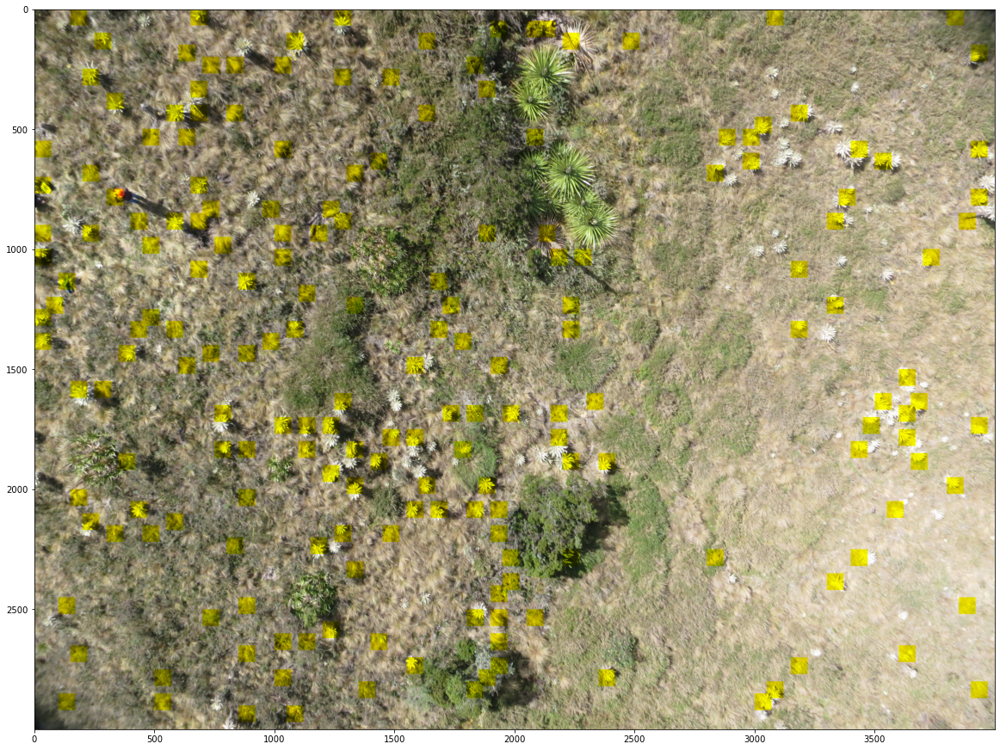

In [84]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_1.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.2 Red multi-capa

In [92]:
# red profunda de 6 capas
model_2 = load_model('modelo_redprofunda_initseed=1_part_seed=8_Init=He.h5')#('modelo_redprofunda_initseed=1_part_seed=8_Init=Normal.h5')

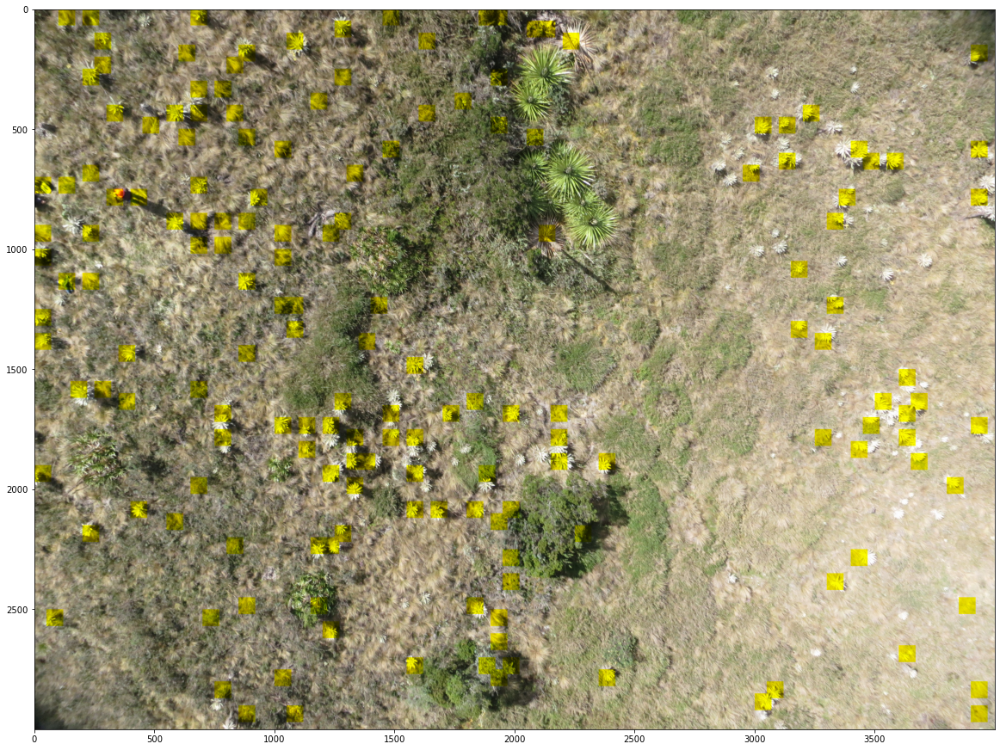

In [93]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_2.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.3 Red Convolucional

In [88]:
# red convolucional sencilla
model_3 = load_model('modelo_CNN_initseed=1_part_seed=3.h5')

Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


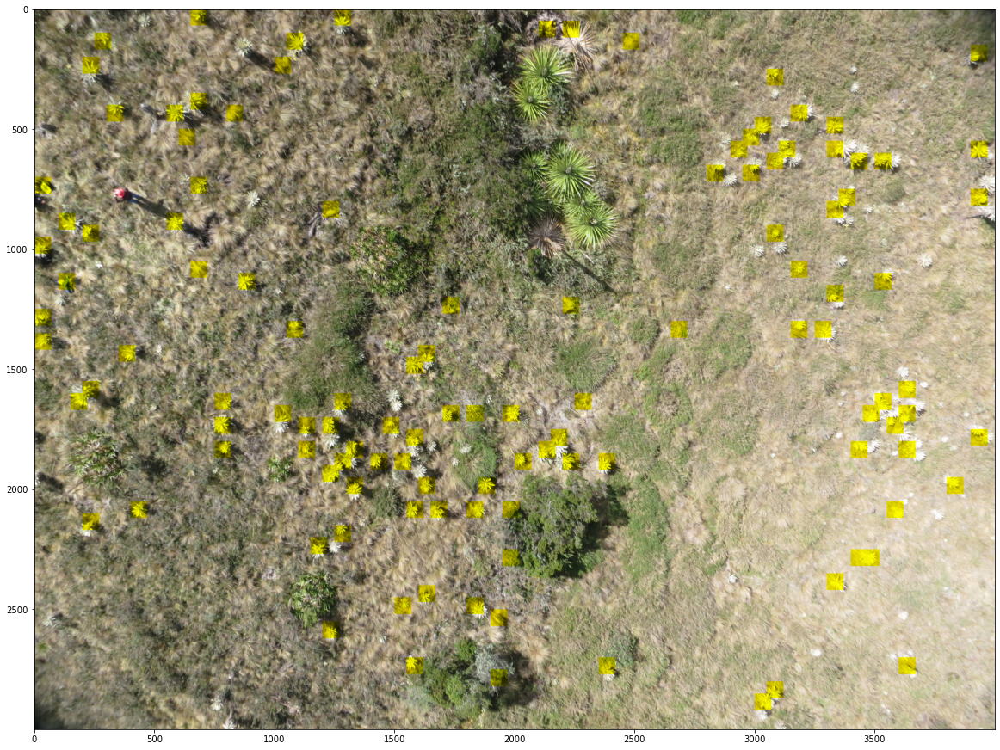

In [89]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_3.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.4 Red Convolucional VGG-16 con transferencia

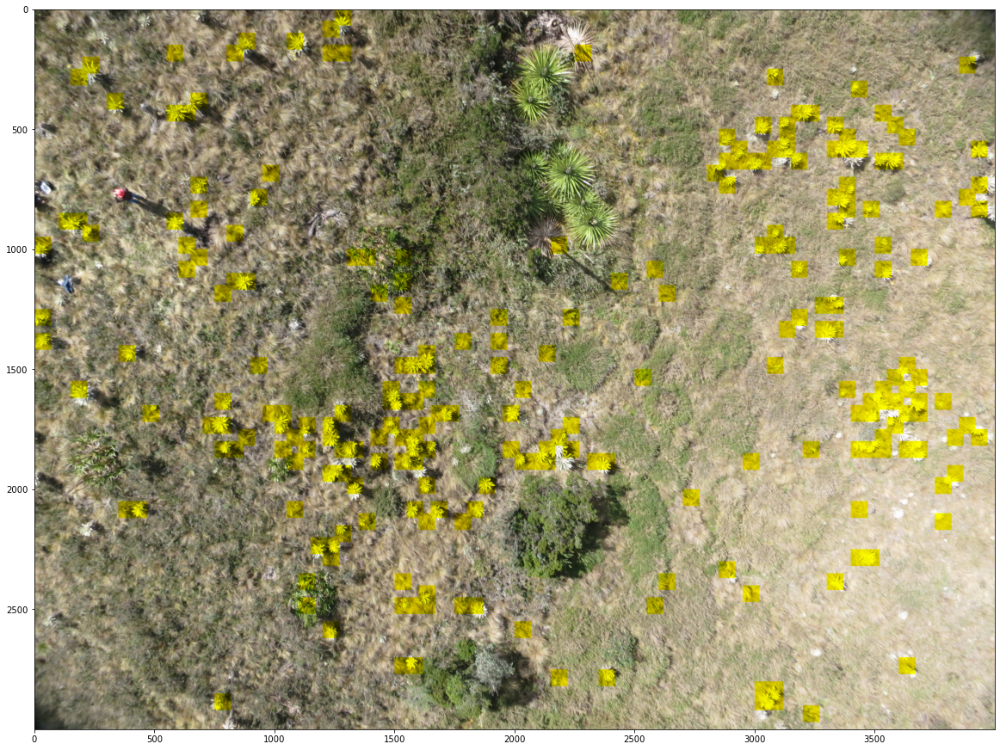

In [90]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model0.predict(subi2)
        Y_preds = model_4.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### Pregunta 2.1

¿Qué puede observar sobre el desempeño de los diferentes modelos? Argumente cuál es el mejor modelo para poner en producción.

##### Claramente el desempeño de la red por transferencia es mucho mejor en la identificación de frailejones en imágenes aéreas comparado con las redes entrenadas anteriormente. 
##### Visualmente se pueden apreciar muy pocos frailejones no identificados, al centro de la imagen y al lado derecho superior. Logra identificar la mayoría de los que se encuentran alrededor, seguramente presenta dificultad por algunas sombras relacionadas.
##### Así mismo, es el modelo con mayor generalización, alcanzando una exactitud de **0.97** en los datos de prueba. Por consiguiente, se considera esta red para una puesta en producción.

##### En cuanto al desempeño de la red convolucional, gráficamente se observa mayor cantidad de falsos positivos con respecto a la red con aprendizaje por transferencia. Algo positivo, ya en esta configuración no se equivoca con la persona en la imagen.

##### Por lo contrario, en cuanto al desempeño de las redes profunda y sencilla, gráficamente se observa mayor cantidad de falsos positivos y falsos negativos, principalmente al costado derecho de la imagen. 

### Ejercicio 2.2

Investigue otra red pre-entrenada dsitinta a la VGG-16 e implemente el aprendizaje por transferencia para la deteccion de frailejones. Argumente por qué su justifica el aprendizaje por transferencia con base en el modelo pre-entrenado de su elección (cómo se relacionan la tarea base y la segunda tarea objetivo).

#### Realizamos la evaluación de 3 redes adicionales pre entrenadas, **ResNet50**, **InceptionV3**, **VGG19**, las cuales se encuentran en la identificación de imágenes en el top10 de mejor desempeño.

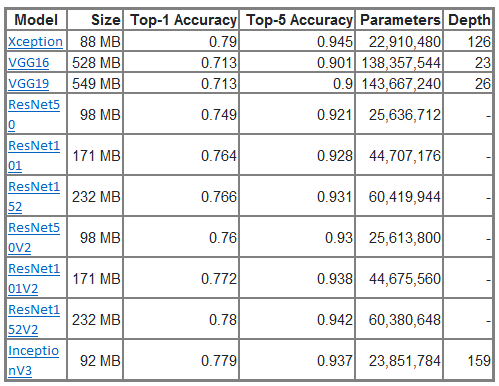

#### **Fuente**: https://keras.io/api/applications/

#### Probamos algunos escenarios en busca de la red con mayor desempeño. 
#### Para estos casos evaluamos los inicializadores **He** y **Xavier**, con un algoritmo de optimización **SGD** y en cuanto a la arquitectura de la red, definimos una capa densamente conectada de 64 perceptrones, con función de activación **relu**, con dropout con tasa de: **0.3** (en redes anteriormente evaluadas se había identificado mejor desempeño con esta tasa), y finalmente nuestra capa de salida con función de activación **Sigmoide**.


In [16]:
from keras.applications.inception_v3 import InceptionV3
from keras.applications.resnet50 import ResNet50

In [17]:
model2_2 = ResNet50(weights='imagenet', include_top=False)

G:\Anaconda3\lib\site-packages\keras_applications\resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


In [18]:
X_preds = model2_2.predict(X)

In [19]:
X_preds.shape

(250, 3, 3, 2048)

In [37]:
initHe = keras.initializers.he_normal(seed=1)
model2_2_1 = Sequential() 
model2_2_1.add(Flatten(input_shape=X_preds.shape[1:])) 
model2_2_1.add(Dense(64, activation='relu', kernel_initializer=initHe, bias_initializer='zeros'))
model2_2_1.add(Dropout(rate=0.3, seed=1))   
model2_2_1.add(Dense(1, activation='sigmoid', kernel_initializer=initHe, bias_initializer='zeros')) 
    
config_transF = model2_2_1.get_config()

In [21]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

sgd = SGD(lr=0.05, momentum=0.09)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X_preds, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('Transfer_ResNet50_sgd_partseed='+str(r)+'.h5')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)

Epoca= 14 , accu_v1=0.4324324332379006 , accu_v2=0.6052631586790085
Epoca= 1 , accu_v1=0.45945946268133214 , accu_v2=0.6052631610318234
Epoca= 7 , accu_v1=0.5405405437624132 , accu_v2=0.6315789505055076
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.6057 | 0.4324 | 0.6053 |   14  |
|  0.6   | 0.4595 | 0.6053 |   1   |
| 0.5771 | 0.5405 | 0.6316 |   7   |
+--------+--------+--------+-------+


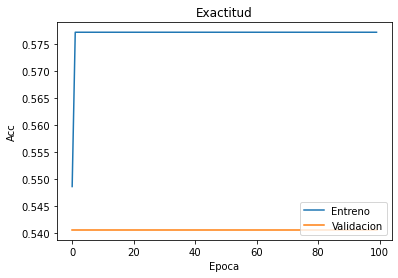

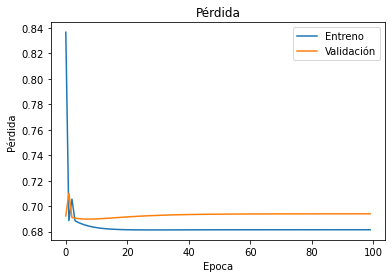

In [22]:
plt.figure(1)
plt.plot(history.history['acc'])  
plt.plot(history.history['val_acc'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

In [23]:
# red convolucional
model2_2_2 = load_model('Transfer_ResNet50_sgd_partseed=1.h5')

model2_2_2.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_4 (Flatten)          (None, 18432)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 64)                1179712   
_________________________________________________________________
dropout_2 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 65        
Total params: 1,179,777
Trainable params: 1,179,777
Non-trainable params: 0
_________________________________________________________________


In [24]:
Y_pred = model2_2_2.predict(X_preds)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[145,   0],
       [105,   0]], dtype=int64)

In [25]:
model2_2 = InceptionV3(weights='imagenet', include_top=False)

In [26]:
X_preds = model2_2.predict(X)

In [27]:
X_preds.shape

(250, 0, 0, 2048)

#### El desempeño de la red calibrada usando el método de aprendizaje por transferencia **ResNet50** no evidencia un buen desempeño. Accuracy promedio de 0.62.

In [28]:
model2_2   = applications.VGG19(include_top=False, weights='imagenet')

In [30]:
X_preds = model2_2.predict(X)

In [31]:
X_preds.shape

(250, 2, 2, 512)

In [32]:
initXavier = keras.initializers.glorot_normal(seed=1)
model2_2_1 = Sequential() 
model2_2_1.add(Flatten(input_shape=X_preds.shape[1:])) 
model2_2_1.add(Dense(64, activation='sigmoid', kernel_initializer=initXavier, bias_initializer='zeros'))
model2_2_1.add(Dropout(rate=0.3, seed=1))   
model2_2_1.add(Dense(1, activation='sigmoid', kernel_initializer=initXavier, bias_initializer='zeros')) 
    
config_transF = model2_2_1.get_config()

In [33]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

sgd = SGD(lr=0.05, momentum=0.09)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(X_preds, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('Transfer_VGG19_sgd_partseed='+str(r)+'.h5')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)

Epoca= 89 , accu_v1=0.972972972972973 , accu_v2=0.9210526315789473
Epoca= 99 , accu_v1=0.9459459459459459 , accu_v2=0.9210526284418608
Epoca= 98 , accu_v1=0.972972972972973 , accu_v2=1.0
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.9943 | 0.973  | 0.9211 |   89  |
| 0.9943 | 0.9459 | 0.9211 |   99  |
| 0.9886 | 0.973  |  1.0   |   98  |
+--------+--------+--------+-------+


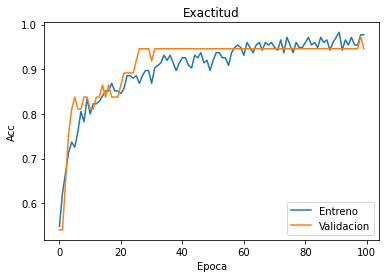

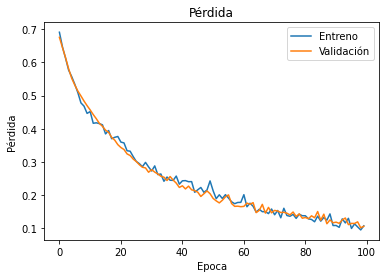

In [34]:
plt.figure(1)
plt.plot(history.history['acc'])  
plt.plot(history.history['val_acc'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

In [35]:
# red convolucional
model2_2_2 = load_model('Transfer_VGG19_sgd_partseed=1.h5')

model2_2_2.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_6 (Flatten)          (None, 2048)              0         
_________________________________________________________________
dense_5 (Dense)              (None, 64)                131136    
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 65        
Total params: 131,201
Trainable params: 131,201
Non-trainable params: 0
_________________________________________________________________


In [36]:
Y_pred = model2_2_2.predict(X_preds)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[145,   0],
       [  3, 102]], dtype=int64)

#### Finalmente evaluamos la red pre entrenada **VGG19**. Para este caso, evaluamos el  inicializador **Xavier**, con algoritmo de optimización **SGD** y en cuanto a la arquitectura de la red, definimos una capa densamente conectada de 64 perceptrones, con función de activación **Sigmoide**, con dropout con tasa de: **0.3** (en redes anteriormente evaluadas se había identificado mejor desempeño con esta tasa), y finalmente nuestra capa de salida con función de activación **Sigmoide**.

#### Así, observamos una mayor generalización de los datos. Accuracy Score superior a 0.92 y para la última iteración Accuracy Score de 1, sobre los datos de prueba.

### Ejercicio 2.3
Construya un algoritmo que utilice el mejor modelo de red neuronal para la detección de poblaciones en la imagen completa IMG_3451.JPG, y estime la densidad para cada población detectada.

*Ayuda:* Mediante un procedimiento sencillo, primero detecte las poblaciones de frailejones y luego estime su densidad, calculada como el numero de frailejones por area poblada.

In [4]:
model2_2   = applications.VGG19(include_top=False, weights='imagenet')
model2_2_2 = load_model('Transfer_VGG19_sgd_partseed=1.h5')


80142336/80134624 [==============================] - 71s 1us/step
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



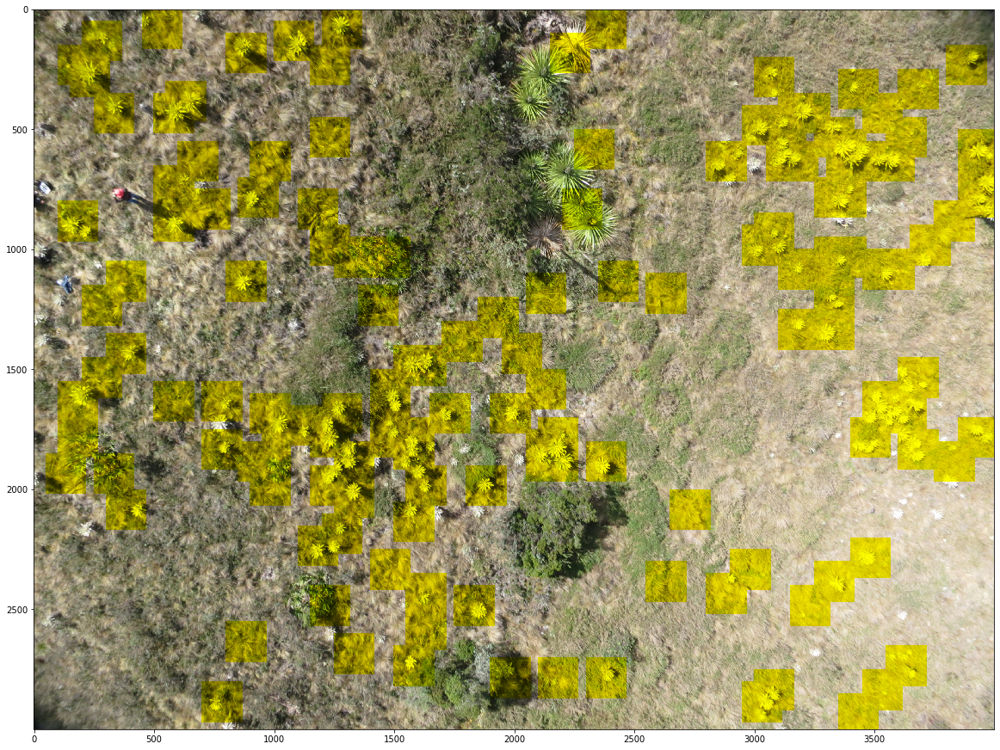

In [8]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x
x_region = np.zeros((x.shape[0],x.shape[1]))
x_pred = np.zeros((x.shape[0],x.shape[1]))

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
r = 50
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model2_2.predict(subi2) # red pre entrenada vgg19
        Y_preds = model2_2_2.predict(feat_subi2) #<-- aquí el mejor modelo
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            if f1>r and c1>r:
                x2[f1-r:f2+r,c1-r:c2+r,2]=0
                x_region[f1-r:f2+r,c1-r:c2+r]=1
                x_pred[f1:f2,c1:c2]=1
            else:
                d = abs(r-f1)
                x2[f1-r+d:f2+r+d,c1-r+d:c2+r+d,2]=0
                x_region[f1-r:f2+r,c1-r:c2+r]=1
                x_pred[f1:f2,c1:c2]=1
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

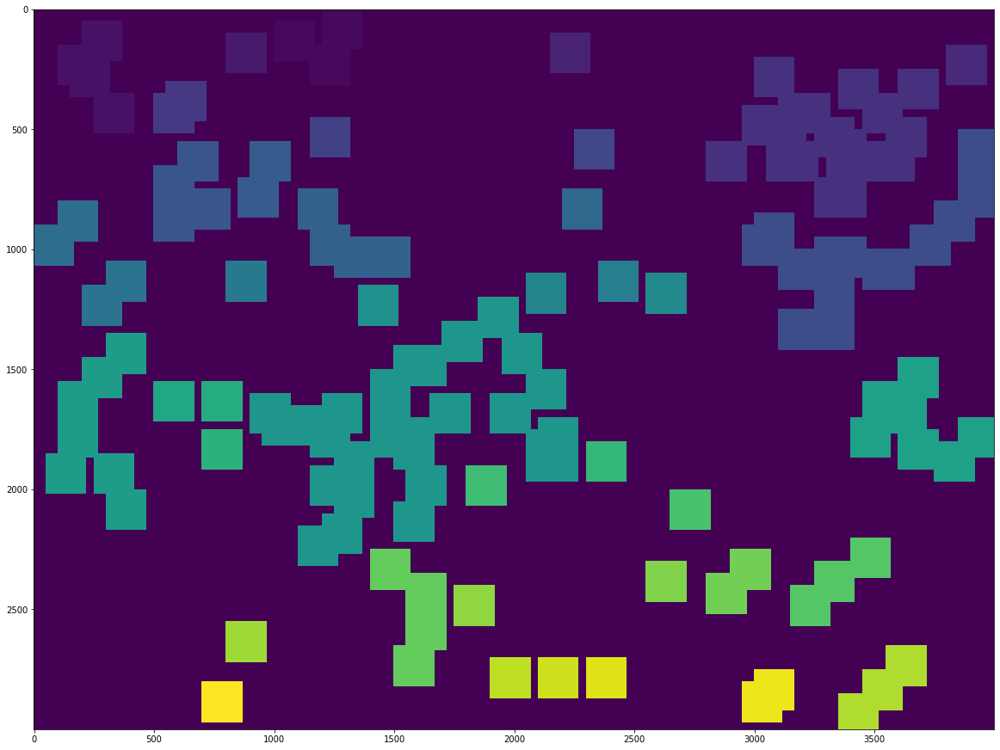

In [9]:
#etiquetando regiones
from skimage import measure
all_labels = measure.label(x_region, background=0)

plt.figure(figsize = (20,20))
plt.imshow(all_labels)

In [10]:
from scipy import stats
n_label = len(set(all_labels.reshape(all_labels.shape[0]*all_labels.shape[1])))

In [11]:
print(f"Se generaron un total de {n_label-1} regiones")

Se generaron un total de 42 regiones


Calculamos las areas y los centros de masa de cada región

In [13]:
from scipy.ndimage.measurements import center_of_mass
num_obj=n_label
surface_areas = np.bincount(all_labels.flat)[1:]
centers = center_of_mass(all_labels, labels=all_labels, index=range(1, num_obj+1))

Para cada región, dividimos las predicciones de frailejones, para obtener una medida de densidad.

In [34]:
x_pred = x_pred.astype(int)
#x_region.flat[
for region in range(1, n_label):
    density = np.bincount(x_pred.flat[all_labels.flat[:]==(region)])[1:][0]/surface_areas[region-1]
    print(f"Para la región {region}, la densidad de frailejones es {density}")
    print(f"Se predijeron { int(np.bincount(x_pred.flat[all_labels.flat[:]==(region)])[1:][0]/(70*70))} frailejones")
    print(f"Sobre un area de {surface_areas[region-1]/(70*70)} unidades cuadradas")
    print("----------------------------------------------------------")

Para la región 1, la densidad de frailejones es 0.1773220747889023
Se predijeron 3 frailejones
Sobre un area de 16.918367346938776 unidades cuadradas
----------------------------------------------------------
Para la región 2, la densidad de frailejones es 0.20447284345047922
Se predijeron 3 frailejones
Sobre un area de 19.163265306122447 unidades cuadradas
----------------------------------------------------------
Para la región 3, la densidad de frailejones es 0.1695501730103806
Se predijeron 1 frailejones
Sobre un area de 5.8979591836734695 unidades cuadradas
----------------------------------------------------------
Para la región 4, la densidad de frailejones es 0.1695501730103806
Se predijeron 1 frailejones
Sobre un area de 5.8979591836734695 unidades cuadradas
----------------------------------------------------------
Para la región 5, la densidad de frailejones es 0.1695501730103806
Se predijeron 1 frailejones
Sobre un area de 5.8979591836734695 unidades cuadradas
-------------

Veamos la región 6, la cual tiene 17 frailejones detectados, para una densidad de 0.23

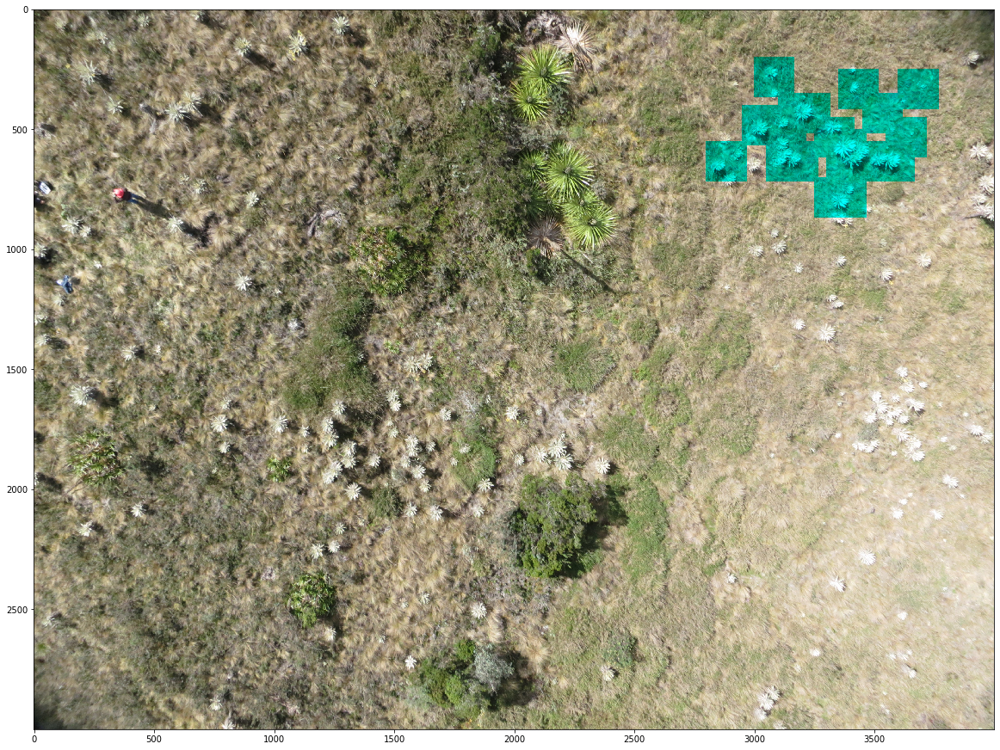

In [45]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x_img = x.reshape(x.shape[0]*x.shape[1], x.shape[2])
x_r = all_labels.reshape(all_labels.shape[0]*all_labels.shape[1])

x_img[x_r[:]==6,0]=0
x_img = x_img.reshape(x.shape[0], x.shape[1], x.shape[2])
plt.figure(figsize = (20,20))
plt.imshow(x_img)

La región mas densa, cuenta con solo tres frailejones, en un área reducida.

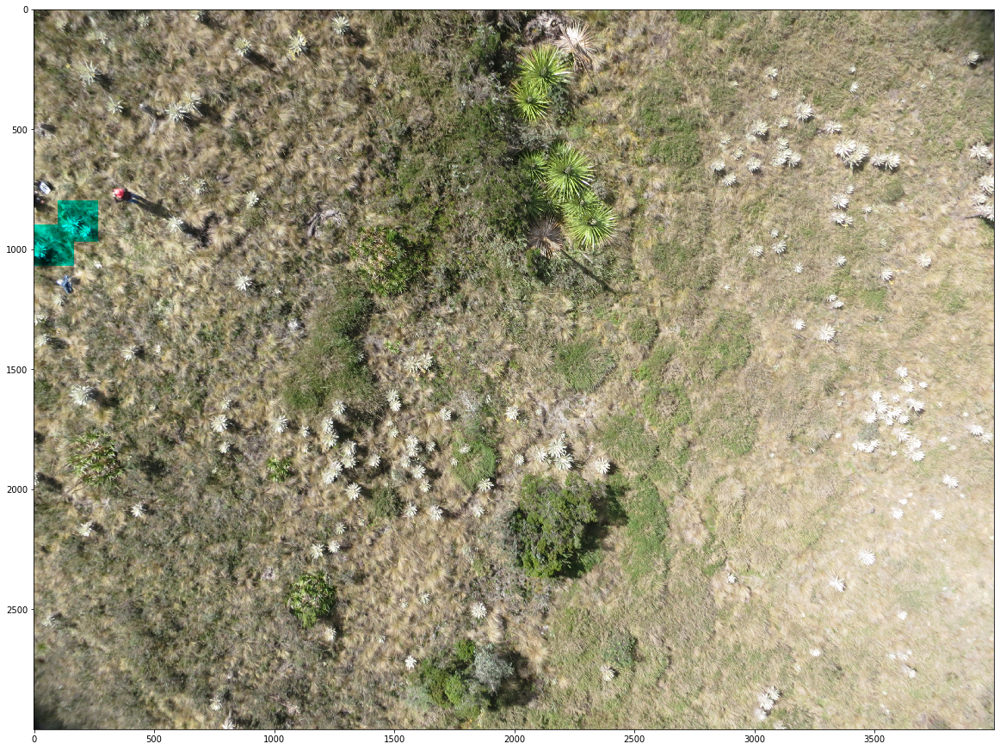

In [37]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x_img = x.reshape(x.shape[0]*x.shape[1], x.shape[2])
x_r = all_labels.reshape(all_labels.shape[0]*all_labels.shape[1])

x_img[x_r[:]==15,0]=0
x_img = x_img.reshape(x.shape[0], x.shape[1], x.shape[2])
plt.figure(figsize = (20,20))
plt.imshow(x_img)

La región con mas frailejones detectados, también es la de mayor área. Con 28 frailejones detectados.

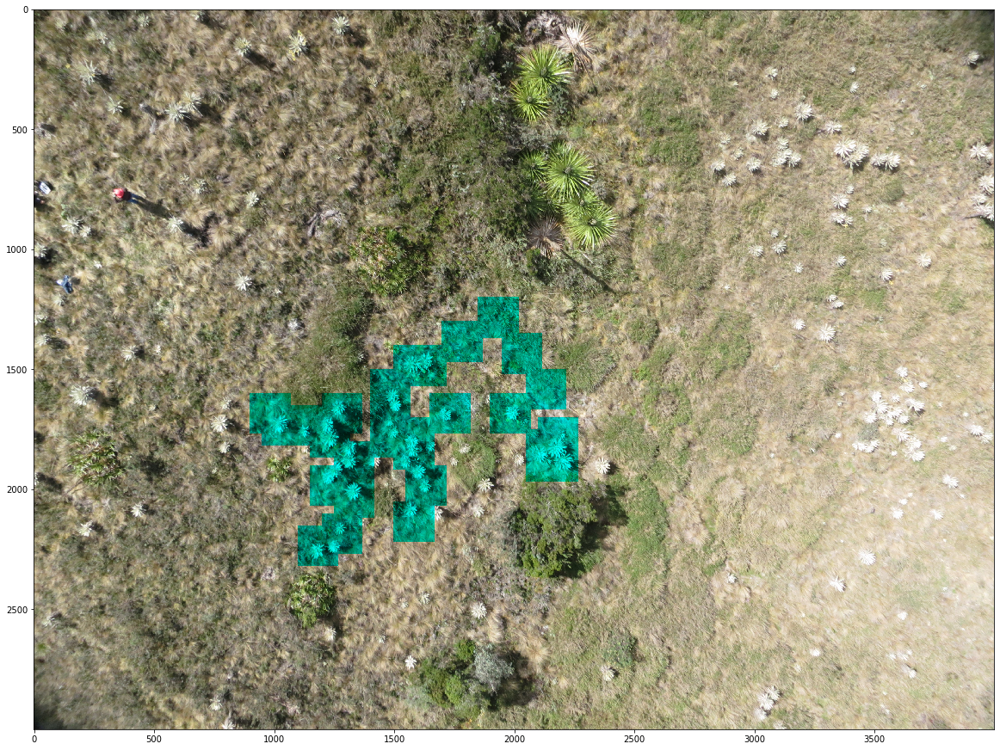

In [39]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x_img = x.reshape(x.shape[0]*x.shape[1], x.shape[2])
x_r = all_labels.reshape(all_labels.shape[0]*all_labels.shape[1])

x_img[x_r[:]==22,0]=0
x_img = x_img.reshape(x.shape[0], x.shape[1], x.shape[2])
plt.figure(figsize = (20,20))
plt.imshow(x_img)